# VectorNet: Clean, structured implementation
This notebook has been refactored to a faithful VectorNet pipeline:
- Robust preprocessing that always selects supervised agents (tracks_to_predict when available, fallback to valid vehicles otherwise) and builds VectorNet-style vector tensors.
- Pure PyTorch VectorNet model: local polyline encoder (segment MLP + max-pool) + global polyline interaction (KNN graph, message passing) + decoder.
- A minimal, reliable training loop with masked loss and concise logging.

You can tweak hyperparameters in the Config cell and re-run the Model and Training cells.

In [ ]:
#%load_ext autoreload
import torch
# dedup_print: print helper that can be asked to only print a message once (useful in notebooks where
_printed_once_set = set()
def dedup_print(*args, key=None, once=True, **kwargs):
    if once:
        k = key if key is not None else ' '.join(map(str, args))
        if k in _printed_once_set:
            return
        _printed_once_set.add(k)
    print(*args, **kwargs)

dedup_print("Torch Version:", torch.__version__)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
if device.type == 'cuda':
    dedup_print("Torch CUDA Available:", torch.cuda.is_available())
    torch.rand(10, device=device)
    dedup_print(torch.cuda.get_device_name(0))


Torch Version: 2.9.0+cu126
Torch CUDA Available: True
Tesla T4


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
cd /content/drive/MyDrive/ColabNotebooks/FRI/MLG_CS224W/Waymo

/content/drive/MyDrive/ColabNotebooks/FRI/MLG_CS224W/Waymo


In [ ]:
'''
# gs://waymo_open_dataset_motion_v_1_3_0/uncompressed/tf_example/training/training_tfexample.tfrecord-00000-of-01000
gs_template = "uncompressed/tf_example/{dataset}/{dataset}_tfexample.tfrecord-{i}-of-{length}"
dataset_name = "scenario"

def get_gs_filename(dataset, i):
    length = ""
    if dataset == "training":
        length = "01000"
    elif dataset == "validation" or dataset == "testing":
        length = "00150"
    else:
        raise ValueError("Invalid dataset name")

    return gs_template.format(dataset=dataset, i=str(i).zfill(5), length=length)

def get_local_filename(dataset, i):
    return f"data/{dataset_name}/{dataset}/{str(i).zfill(5)}.tfrecord"
project_id = "waymo-gnn-475616"
bucket_name = "waymo_open_dataset_motion_v_1_3_0"
from google.cloud import storage
import os
import base64
import json
from google.oauth2.credentials import Credentials as UserCredentials
# from google.oauth2.service_account import Credentials as ServiceAccountCredentials

adc_info = None
if adc_info is not None:
    # credentials = ServiceAccountCredentials.from_service_account_info(adc_info)
    # can throw if the info is not valid
    credentials = UserCredentials.from_authorized_user_info(adc_info)
    storage_client = storage.Client(project=project_id, credentials=credentials)

bucket = storage_client.bucket(bucket_name, user_project=project_id)
for i in range(8):
    # for dataset in ["training", "validation", "testing"]:
    for dataset in ["training", "validation"]:
        gs_filename = get_gs_filename(dataset, i)
        blob = bucket.blob(gs_filename)

        local_filename = get_local_filename(dataset, i)
        # ensure parent directory exists before opening the file
        os.makedirs(os.path.dirname(local_filename), exist_ok=True)
        try:
            # https://github.com/waymo-research/waymo-open-dataset/issues/819#issuecomment-2082120142
            blob.download_to_filename(filename=local_filename)
            print("Downloaded:", local_filename)
        except Exception as e:
            print("Failed to write", local_filename, ":", repr(e))
'''

'\n# gs://waymo_open_dataset_motion_v_1_3_0/uncompressed/tf_example/training/training_tfexample.tfrecord-00000-of-01000\ngs_template = "uncompressed/tf_example/{dataset}/{dataset}_tfexample.tfrecord-{i}-of-{length}"\ndataset_name = "scenario"\n\ndef get_gs_filename(dataset, i):\n    length = ""\n    if dataset == "training":\n        length = "01000"\n    elif dataset == "validation" or dataset == "testing":\n        length = "00150"\n    else:\n        raise ValueError("Invalid dataset name")\n\n    return gs_template.format(dataset=dataset, i=str(i).zfill(5), length=length)\n\ndef get_local_filename(dataset, i):\n    return f"data/{dataset_name}/{dataset}/{str(i).zfill(5)}.tfrecord"\nproject_id = "waymo-gnn-475616"\nbucket_name = "waymo_open_dataset_motion_v_1_3_0"\nfrom google.cloud import storage\nimport os\nimport base64\nimport json\nfrom google.oauth2.credentials import Credentials as UserCredentials\n# from google.oauth2.service_account import Credentials as ServiceAccountCrede

In [ ]:
'''
# Ensure .tfindex files exist for the TFRecord folders (training & validation)
import os, glob, subprocess, sys


def ensure_tfindex(folder_path):
    # find .tfrecord files in folder
    tfpaths = sorted(glob.glob(os.path.join(folder_path, '*.tfrecord')))
    if not tfpaths:
        print(f'No .tfrecord files found in {folder_path}')
        return
    missing = []
    for tp in tfpaths:
        base = os.path.splitext(os.path.basename(tp))[0]
        idx_path = os.path.join(folder_path, base + '.tfindex')
        if not os.path.exists(idx_path):
            missing.append((tp, idx_path))
    if not missing:
        print(f'All .tfindex files already present in {folder_path} (checked {len(tfpaths)} files)')
        return
    print(f'Creating .tfindex for {len(missing)} files in {folder_path}...')
    # invoke the tfrecord indexer on the folder (the tool creates .tfindex for all .tfrecord files in the folder)
    cmd = [sys.executable, '-m', 'tfrecord.tools.tfrecord2idx', folder_path]
    try:
        subprocess.check_call(cmd)
        print('tfrecord2idx completed successfully for', folder_path)
    except FileNotFoundError:
        print('Error: tfrecord.tools.tfrecord2idx not found. Is the `tfrecord` package installed in the current environment?')
        print('You can install it with: pip install tfrecord')
    except subprocess.CalledProcessError as e:
        print('tfrecord2idx failed with return code', e.returncode)


# Folders to ensure
folders = ['data/scenario/training', 'data/scenario/validation']
for f in folders:
    if os.path.isdir(f):
        ensure_tfindex(f)
    else:
        print(f'Folder not found: {f}')
'''

"\n# Ensure .tfindex files exist for the TFRecord folders (training & validation)\nimport os, glob, subprocess, sys\n\n\ndef ensure_tfindex(folder_path):\n    # find .tfrecord files in folder\n    tfpaths = sorted(glob.glob(os.path.join(folder_path, '*.tfrecord')))\n    if not tfpaths:\n        print(f'No .tfrecord files found in {folder_path}')\n        return\n    missing = []\n    for tp in tfpaths:\n        base = os.path.splitext(os.path.basename(tp))[0]\n        idx_path = os.path.join(folder_path, base + '.tfindex')\n        if not os.path.exists(idx_path):\n            missing.append((tp, idx_path))\n    if not missing:\n        print(f'All .tfindex files already present in {folder_path} (checked {len(tfpaths)} files)')\n        return\n    print(f'Creating .tfindex for {len(missing)} files in {folder_path}...')\n    # invoke the tfrecord indexer on the folder (the tool creates .tfindex for all .tfrecord files in the folder)\n    cmd = [sys.executable, '-m', 'tfrecord.tools.tfr

In [ ]:
!pip install tfrecord
!pip install torch_geometric
# https://github.com/vahidk/tfrecord
#!python -m tfrecord.tools.tfrecord2idx data/scenario/training/ # create index record for .tfrecord files

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.0/80.0 kB 6.9 MB/s eta 0:00:00
  Created wheel for tfrecord: filename=tfrecord-1.14.6-py3-none-any.whl size=14834 sha256=b5e70c7fd4bd873dffb923ce5c3522b513d7be8961791c8fac037c7d9c3cce1d
  Stored in directory: /root/.cache/pip/wheels/bf/00/32/db9abfb84508d182806ca91e7391ca865d5037e585c088e8e6
Successfully built tfrecord
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.7/63.7 kB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 62.7 MB/s eta 0:00:00


In [ ]:
# Configuration and Hyperparameters (paper-aligned + stabilized)

import torch
import random
import numpy as np

SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)

# Determinism (can reduce throughput, but improves reproducibility for debugging)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

config = {
    # ---- Data / normalization ----
    # Coordinates are centered around the target agent at the last observed step (paper-aligned, prevents large absolute magnitudes)
    'vectornet_normalize': True,
    # Internal scale used only inside the NLL computation (keep = 1.0 if your deltas are already in meters)
    'coord_scale': 1.0,
    # Sampling period (Waymo: 10Hz => 0.1s). Used only for reporting DE@t.
    'dt_seconds': 0.1,

    # ---- Forecast horizon ----
    'future_len': 80,            # Waymo standard is 80 future steps (8s at 0.1s)

    # ---- Model ----
    'hidden_dim': 128,
    'num_heads': 4,
    'attn_dropout': 0.1,
    'num_iterations': 1,
    # Masked polyline modeling (paper L_node)
    'node_mask_ratio': 0.15,
    'mask_target_polyline': True,

    # ---- Optimization ----
    'learning_rate': 5e-6,
    'weight_decay': 1e-4,
    'batch_size': 8,
    'num_epochs': 300,
    'grad_clip': 1.0,

    # ReduceLROnPlateau settings (on validation objective)
    'lr_scheduler': 'plateau',
    'lr_factor': 0.5,
    'lr_patience': 4,
    'min_lr': 1e-6,

    # Gaussian head stability (sigma floors in *meters*, after coord_scale is applied in the loss)
    'sigma_floor': 0.30,
    'min_log_sigma': -2.5,
    'max_log_sigma': 2.0,

    # Validation evaluation control (paper-style evaluation: deterministic, fixed subset if desired)
    'fixed_val_eval': True,
    'fixed_val_seed': 42,

    # Dataset sampling (if you keep these controls elsewhere in the notebook)
    'max_scenarios': 1024,
    'val_scenarios': 512,

    # Lambda to wigh node and trajectory predictions
    'lambda_node': 10.0,

    # Device selection
    'device': 'cuda' if torch.cuda.is_available() else 'cpu',
}

print("Config (key hyperparameters):")
for k in [
    'device','future_len','dt_seconds','hidden_dim','num_heads','attn_dropout',
    'node_mask_ratio','learning_rate','weight_decay','batch_size','num_epochs',
    'coord_scale','sigma_floor','grad_clip','lr_factor','lr_patience','min_lr'
]:
    print(f"  {k}: {config[k]}")

Config (key hyperparameters):
  device: cuda
  future_len: 80
  dt_seconds: 0.1
  hidden_dim: 128
  num_heads: 4
  attn_dropout: 0.1
  node_mask_ratio: 0.15
  learning_rate: 5e-06
  weight_decay: 0.0001
  batch_size: 8
  num_epochs: 150
  coord_scale: 1.0
  sigma_floor: 0.3
  grad_clip: 1.0
  lr_factor: 0.5
  lr_patience: 4
  min_lr: 1e-06


In [ ]:
import glob
from tfrecord.torch.dataset import MultiTFRecordDataset
from torch.utils.data import DataLoader

# ---- TFRecord file discovery ----
train_files = sorted(glob.glob("data/scenario/training/*.tfrecord"))
val_files = sorted(glob.glob("data/scenario/validation/*.tfrecord"))

if len(train_files) == 0 or len(val_files) == 0:
    print("Warning: No TFRecord files found under data/scenario/... .")
    print("If you are running locally, ensure the dataset is downloaded and paths are correct.")

# Use file stems as split keys (00000, 00001, ...)
train_splits = {f"{i:05d}": 1.0 / max(1, len(train_files)) for i, _ in enumerate(train_files)}
val_splits = {f"{i:05d}": 1.0 / max(1, len(val_files)) for i, _ in enumerate(val_files)}

train_tfrecord_pattern = "data/scenario/training/{}.tfrecord"
train_index_pattern = "data/scenario/training/{}.tfindex"
val_tfrecord_pattern = "data/scenario/validation/{}.tfrecord"
val_index_pattern = "data/scenario/validation/{}.tfindex"

# `description` must be defined in a previous cell (feature schema for the TFRecords).
description = None # use all key, slower

# If you used the Waymo Motion TFRecord schema, keep that cell unchanged.
train_dataset = MultiTFRecordDataset(
    train_tfrecord_pattern,
    train_index_pattern,
    train_splits,
    description,
    infinite=False,
    shuffle_queue_size=64,
)
val_dataset = MultiTFRecordDataset(
    val_tfrecord_pattern,
    val_index_pattern,
    val_splits,
    description,
    infinite=False,
    shuffle_queue_size=64,
)

train_loader = DataLoader(
    train_dataset,
    batch_size=int(config['batch_size']),
    num_workers=4,
    pin_memory=True,
)
val_loader = DataLoader(
    val_dataset,
    batch_size=int(config['batch_size']),
    num_workers=4,
    pin_memory=True,
)

/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


In [ ]:
import torch
import math

def preprocess_waymo_batch(batch, config):
    """
    Build per-scenario tensors for agents, roadgraph, traffic lights and labels.

    Updates to match VectorNet paper framework:
    - Rotate coordinates based on target vehicle heading at last observed/current step.
    - Labels parameterized as per-step offsets (deltas), starting from last observed location.
    - Uses ONLY the same indexing style as the original pasted cell (flattened slices).
    """
    device = config.get('device', None)
    normalize = config.get('vectornet_normalize', config.get('vector_normalise', False))
    future_len = config.get('future_len', 80)
    if future_len is None:
        raise ValueError("config['future_len'] must be set")

    B = batch['state/tracks_to_predict'].shape[0]

    # Output collectors
    agents_out, roads_out, lights_out, labels_out = [], [], [], []
    idx_agents_out, idx_roads_out, idx_lights_out = [], [], []
    target_pids_out = []

    ROAD_TYPE_COUNT = 20
    TL_STATE_COUNT = 9
    day_micros = 86400 * 1_000_000
    conv = 2.0 * math.pi / day_micros

    def build_index_map(t: torch.Tensor):
        m = {}
        if t.numel() == 0:
            return m, torch.empty((0, t.shape[1] - 1), dtype=t.dtype, device=t.device)
        ids = t[:, -1].to(torch.long).tolist()
        t_sliced = t[:, :-1]
        for r, pid in enumerate(ids):
            key = int(pid)
            m.setdefault(key, []).append(r)
        return m, t_sliced

    def rot_xy(x, y, yaw):
        """Rotate (x,y) by -yaw; yaw is python float radians. x,y can be scalars or tensors."""
        c = math.cos(-yaw)
        s = math.sin(-yaw)
        xr = c * x - s * y
        yr = s * x + c * y
        return xr, yr

    for i in range(B):

        # --- NORMALIZATION FIX START ---
        # Determine origin (ox, oy, oz) + rotation yaw
        if normalize:
            ttp = batch['state/tracks_to_predict'][i]
            sel = torch.nonzero(ttp == 1, as_tuple=False)

            if sel.numel() > 0:
                ref_idx = int(sel[0][0])
            else:
                ref_idx = 0

            ox = batch['state/current/x'][i, ref_idx].item()
            oy = batch['state/current/y'][i, ref_idx].item()
            oz = batch['state/current/z'][i, ref_idx].item()

            # rotation based on target heading at last observed/current step (paper)
            if 'state/current/bbox_yaw' in batch:
                origin_yaw = batch['state/current/bbox_yaw'][i, ref_idx].item()
            else:
                origin_yaw = 0.0
        else:
            ox = oy = oz = 0.0
            origin_yaw = 0.0
        # --- NORMALIZATION FIX END ---

        # Labels + target agent pid list
        # Default to agent 0 if no track_to_predict found (matches normalization fallback)
        target_ids = torch.tensor([0])
        for j, target in enumerate(batch['state/tracks_to_predict'][i]):
            if target == 1:
                target_ids = torch.tensor([j])
                break

        scenario_target_pids = [int(t.item()) for t in target_ids]
        labs = []

        # Rotation: align to target vehicle heading at last observed location
        # (paper: rotate coordinate system based on heading at last observed step)
        if 'state/current/bbox_yaw' in batch:
            origin_yaw = batch['state/current/bbox_yaw'][i, int(target_ids[0].item())].item()
        else:
            origin_yaw = 0.0

        for tid in scenario_target_pids:
            cx = batch['state/current/x'][i, tid].item()
            cy = batch['state/current/y'][i, tid].item()

            fx = batch['state/future/x'][i, tid*future_len:(tid+1)*future_len]
            fy = batch['state/future/y'][i, tid*future_len:(tid+1)*future_len]

            # Local coordinates:
            # - if normalize: origin is (ox, oy)
            # - else: origin is current position (cx, cy)
            if normalize:
                x0 = fx - ox
                y0 = fy - oy
                cxl = cx - ox
                cyl = cy - oy
            else:
                x0 = fx - cx
                y0 = fy - cy
                cxl = 0.0
                cyl = 0.0

            # Rotate into target-heading-aligned frame
            x0r, y0r = rot_xy(x0, y0, origin_yaw)
            cxlr, cylr = rot_xy(torch.tensor(cxl, dtype=x0.dtype), torch.tensor(cyl, dtype=y0.dtype), origin_yaw)

            # Convert absolute offsets to per-step deltas (paper-style)
            # delta[0] = pos[0] - current_pos
            # delta[t] = pos[t] - pos[t-1]
            prev_x = torch.cat([cxlr.view(1), x0r[:-1]], dim=0)
            prev_y = torch.cat([cylr.view(1), y0r[:-1]], dim=0)

            dx = x0r - prev_x
            dy = y0r - prev_y

            labs.append(torch.stack([dx, dy], dim=1))
            break  # only first target agent per scenario

        labels = torch.stack(labs, dim=0) if len(labs) else torch.zeros((0, future_len, 2), dtype=torch.float32)
        if device:
            labels = labels.to(device)

        # Agents segments
        agent_segments = []
        if 'state/past/x' in batch:
            past_steps = batch['state/past/x'].shape[1] // batch['state/tracks_to_predict'].shape[1]
            past_steps = int(past_steps) if past_steps > 0 else 10
        else:
            past_steps = 10

        agent_idxs = (batch['state/tracks_to_predict'][i] > -2).nonzero(as_tuple=True)[0]

        for j in agent_idxs:
            j = int(j.item())

            # Past arrays (same indexing as original)
            if 'state/past/x' in batch:
                px = batch['state/past/x'][i, j*past_steps:(j+1)*past_steps]
                py = batch['state/past/y'][i, j*past_steps:(j+1)*past_steps]
                pz = batch['state/past/z'][i, j*past_steps:(j+1)*past_steps]
                pvalid = batch['state/past/valid'][i, j*past_steps:(j+1)*past_steps]
            else:
                px = py = pz = torch.zeros(past_steps)
                pvalid = torch.zeros(past_steps)

            # Current
            cx = batch['state/current/x'][i, j].item()
            cy = batch['state/current/y'][i, j].item()
            cz = batch['state/current/z'][i, j].item()
            cvalid = batch['state/current/valid'][i, j].item() if 'state/current/valid' in batch else 1

            vidx = (pvalid == 1).nonzero(as_tuple=True)[0]
            if (cvalid == 0 and vidx.numel() < 5):
                continue

            if vidx.numel() == 0:
                # Single node: Ds=De at current position (normalized), rotated
                dx = (cx - ox)
                dy = (cy - oy)
                dx, dy = rot_xy(dx, dy, origin_yaw)

                Ds = torch.tensor([dx, dy, cz - oz])
                De = Ds.clone()

                vx = vy = vz = 0.0
                vyaw = 0.0
                byaw = batch['state/current/bbox_yaw'][i, j].item() if 'state/current/bbox_yaw' in batch else 0.0

                length = batch['state/current/length'][i, j].item() if 'state/current/length' in batch else 0.0
                width  = batch['state/current/width'][i, j].item()  if 'state/current/width' in batch else 0.0
                is_sdc = float(batch['state/is_sdc'][i, j].item()) if 'state/is_sdc' in batch else 0.0

                tcur = batch['state/current/timestamp_micros'][i, j].item() if 'state/current/timestamp_micros' in batch else 0
                th = (tcur % day_micros) * conv
                ts_sin, ts_cos = math.sin(th), math.cos(th)
                ts_sin_prev, ts_cos_prev = 0.0, 0.0

                # Rotate velocity components too (if you ever set them here)
                vx_r, vy_r = rot_xy(vx, vy, origin_yaw)
                vx, vy = float(vx_r), float(vy_r)

                a = torch.tensor([vx, vy, vz, vyaw, byaw, length, width, is_sdc, ts_sin, ts_cos, ts_sin_prev, ts_cos_prev])
                pid = torch.tensor([j], dtype=torch.float32)
                agent_segments.append(torch.cat([Ds, De, a, pid]))
            else:
                last_valid_t = int(vidx[0].item())
                for t in vidx.tolist()[1:]:
                    x0, y0, z0 = px[last_valid_t].item(), py[last_valid_t].item(), pz[last_valid_t].item()
                    x1, y1, z1 = px[t].item(),            py[t].item(),            pz[t].item()

                    dx0, dy0 = (x0 - ox), (y0 - oy)
                    dx1, dy1 = (x1 - ox), (y1 - oy)
                    dx0, dy0 = rot_xy(dx0, dy0, origin_yaw)
                    dx1, dy1 = rot_xy(dx1, dy1, origin_yaw)

                    Ds = torch.tensor([dx0, dy0, z0 - oz])
                    De = torch.tensor([dx1, dy1, z1 - oz])

                    vx = batch['state/past/velocity_x'][i, j*past_steps + t].item() if 'state/past/velocity_x' in batch else 0.0
                    vy = batch['state/past/velocity_y'][i, j*past_steps + t].item() if 'state/past/velocity_y' in batch else 0.0
                    vz = batch['state/past/velocity_z'][i, j*past_steps + t].item() if 'state/past/velocity_z' in batch else 0.0
                    vyaw = batch['state/past/vel_yaw'][i, j*past_steps + t].item() if 'state/past/vel_yaw' in batch else 0.0
                    byaw = batch['state/current/bbox_yaw'][i, j].item() if 'state/current/bbox_yaw' in batch else 0.0
                    length = batch['state/current/length'][i, j].item() if 'state/current/length' in batch else 0.0
                    width  = batch['state/current/width'][i, j].item()  if 'state/current/width' in batch else 0.0
                    is_sdc = float(batch['state/is_sdc'][i, j].item()) if 'state/is_sdc' in batch else 0.0

                    if 'state/past/timestamp_micros' in batch:
                        t_m = batch['state/past/timestamp_micros'][i, j*past_steps + t].item()
                        t_p = batch['state/past/timestamp_micros'][i, j*past_steps + last_valid_t].item()
                    else:
                        t_m, t_p = 0, 0
                    th, thp = (t_m % day_micros) * conv, (t_p % day_micros) * conv
                    ts_sin, ts_cos = math.sin(th), math.cos(th)
                    ts_sin_prev, ts_cos_prev = math.sin(thp), math.cos(thp)

                    # Rotate velocity components
                    vx_r, vy_r = rot_xy(vx, vy, origin_yaw)
                    vx, vy = float(vx_r), float(vy_r)

                    a = torch.tensor([vx, vy, vz, vyaw, byaw, length, width, is_sdc, ts_sin, ts_cos, ts_sin_prev, ts_cos_prev])
                    pid = torch.tensor([j], dtype=torch.float32)
                    agent_segments.append(torch.cat([Ds, De, a, pid]))
                    last_valid_t = t

                if cvalid == 1:
                    x0, y0, z0 = px[last_valid_t].item(), py[last_valid_t].item(), pz[last_valid_t].item()

                    dx0, dy0 = (x0 - ox), (y0 - oy)
                    dx1, dy1 = (cx - ox), (cy - oy)
                    dx0, dy0 = rot_xy(dx0, dy0, origin_yaw)
                    dx1, dy1 = rot_xy(dx1, dy1, origin_yaw)

                    Ds = torch.tensor([dx0, dy0, z0 - oz])
                    De = torch.tensor([dx1, dy1, cz - oz])

                    vx = batch['state/past/velocity_x'][i, j*past_steps + last_valid_t].item() if 'state/past/velocity_x' in batch else 0.0
                    vy = batch['state/past/velocity_y'][i, j*past_steps + last_valid_t].item() if 'state/past/velocity_y' in batch else 0.0
                    vz = batch['state/past/velocity_z'][i, j*past_steps + last_valid_t].item() if 'state/past/velocity_z' in batch else 0.0
                    vyaw = batch['state/past/vel_yaw'][i, j*past_steps + last_valid_t].item() if 'state/past/vel_yaw' in batch else 0.0
                    byaw = batch['state/current/bbox_yaw'][i, j].item() if 'state/current/bbox_yaw' in batch else 0.0
                    length = batch['state/current/length'][i, j].item() if 'state/current/length' in batch else 0.0
                    width  = batch['state/current/width'][i, j].item()  if 'state/current/width' in batch else 0.0
                    is_sdc = float(batch['state/is_sdc'][i, j].item()) if 'state/is_sdc' in batch else 0.0

                    t_c = batch['state/current/timestamp_micros'][i, j].item() if 'state/current/timestamp_micros' in batch else 0
                    t_p = batch['state/past/timestamp_micros'][i, j*past_steps + last_valid_t].item() if 'state/past/timestamp_micros' in batch else 0
                    th, thp = (t_c % day_micros) * conv, (t_p % day_micros) * conv
                    ts_sin, ts_cos = math.sin(th), math.cos(th)
                    ts_sin_prev, ts_cos_prev = math.sin(thp), math.cos(thp)

                    # Rotate velocity components
                    vx_r, vy_r = rot_xy(vx, vy, origin_yaw)
                    vx, vy = float(vx_r), float(vy_r)

                    a = torch.tensor([vx, vy, vz, vyaw, byaw, length, width, is_sdc, ts_sin, ts_cos, ts_sin_prev, ts_cos_prev])
                    pid = torch.tensor([j], dtype=torch.float32)
                    agent_segments.append(torch.cat([Ds, De, a, pid]))

        agents = torch.stack(agent_segments) if len(agent_segments) else torch.zeros((0, 18))

        # Roadgraph segments
        road_segments = []
        if 'roadgraph_samples/xyz' in batch:
            xyz = batch['roadgraph_samples/xyz'][i]
            rg_id = batch['roadgraph_samples/id'][i]
            rg_type = batch['roadgraph_samples/type'][i]
            rg_valid = batch['roadgraph_samples/valid'][i]
            step = 3
            N = xyz.shape[0] // step
            prev = None
            prev_id = None
            for k in range(N):
                if rg_valid[k].item() == 0:
                    break
                x, y, z = xyz[k*step + 0], xyz[k*step + 1], xyz[k*step + 2]
                cid = int(rg_id[k].item())
                if prev_id is None or cid != prev_id:
                    # rotate prev point into frame
                    px, py = rot_xy((x - ox), (y - oy), origin_yaw)
                    prev = (px, py, (z - oz))
                    prev_id = cid
                    continue

                Ds = torch.tensor([prev[0], prev[1], prev[2]])
                x1, y1 = rot_xy((x - ox), (y - oy), origin_yaw)
                De = torch.tensor([x1, y1, (z - oz)])

                typ = int(rg_type[k].item())
                type_oh = torch.zeros(ROAD_TYPE_COUNT)
                if 0 <= typ < ROAD_TYPE_COUNT:
                    type_oh[typ] = 1.0
                a = type_oh
                pid = torch.tensor([cid], dtype=torch.float32)
                road_segments.append(torch.cat([Ds, De, a, pid]))

                prev = (x1, y1, (z - oz))
                prev_id = cid

        roads = torch.stack(road_segments) if len(road_segments) else torch.zeros((0, 6 + ROAD_TYPE_COUNT + 1))

        # Traffic light segments
        light_segments = []
        if 'traffic_light_state/past/x' in batch:
            L = batch['traffic_light_state/current/state'].shape[1]
            TL_past = 10
            for lj in range(L):
                cur_valid = batch['traffic_light_state/current/valid'][i, lj].item()
                past_valid = batch['traffic_light_state/past/valid'][i, lj*TL_past:(lj+1)*TL_past]
                if cur_valid == 0 and past_valid.sum().item() == 0:
                    continue

                lx = batch['traffic_light_state/current/x'][i, lj].item()
                ly = batch['traffic_light_state/current/y'][i, lj].item()
                lz = batch['traffic_light_state/current/z'][i, lj].item()

                if cur_valid == 0:
                    vidx = (past_valid == 1).nonzero(as_tuple=True)[0]
                    if vidx.numel() == 0:
                        continue
                    last = int(vidx[-1].item())
                    lx = batch['traffic_light_state/past/x'][i, lj*TL_past + last].item()
                    ly = batch['traffic_light_state/past/y'][i, lj*TL_past + last].item()
                    lz = batch['traffic_light_state/past/z'][i, lj*TL_past + last].item()

                # rotate light position into frame
                px, py = rot_xy((lx - ox), (ly - oy), origin_yaw)
                pz = lz - oz

                for t in range(TL_past):
                    if past_valid[t].item() == 0:
                        continue
                    st = int(batch['traffic_light_state/past/state'][i, lj*TL_past + t].item())
                    st_oh = torch.zeros(TL_STATE_COUNT)
                    if 0 <= st < TL_STATE_COUNT:
                        st_oh[st] = 1.0
                    t_m = batch['traffic_light_state/past/timestamp_micros'][i, t].item() if 'traffic_light_state/past/timestamp_micros' in batch else 0
                    th = (t_m % day_micros) * conv
                    ts_sin, ts_cos = math.sin(th), math.cos(th)

                    Ds = torch.tensor([px, py, pz])
                    De = torch.tensor([px, py, pz])
                    a = torch.cat([st_oh, torch.tensor([ts_sin, ts_cos])])
                    pid = torch.tensor([lj], dtype=torch.float32)
                    light_segments.append(torch.cat([Ds, De, a, pid]))

                if cur_valid == 1:
                    st = int(batch['traffic_light_state/current/state'][i, lj].item())
                    st_oh = torch.zeros(TL_STATE_COUNT)
                    if 0 <= st < TL_STATE_COUNT:
                        st_oh[st] = 1.0
                    t_m = batch['traffic_light_state/current/timestamp_micros'][i].item() if 'traffic_light_state/current/timestamp_micros' in batch else 0
                    th = (t_m % day_micros) * conv
                    ts_sin, ts_cos = math.sin(th), math.cos(th)

                    Ds = torch.tensor([px, py, pz])
                    De = torch.tensor([px, py, pz])
                    a = torch.cat([st_oh, torch.tensor([ts_sin, ts_cos])])
                    pid = torch.tensor([lj], dtype=torch.float32)
                    light_segments.append(torch.cat([Ds, De, a, pid]))

        lights = torch.stack(light_segments) if len(light_segments) else torch.zeros((0, 6 + TL_STATE_COUNT + 2 + 1))

        # Build index maps on CPU-tensors
        idx_agents, agents = build_index_map(agents)
        idx_roads, roads  = build_index_map(roads)
        idx_lights, lights = build_index_map(lights)

        if device:
            agents = agents.to(device)
            roads  = roads.to(device)
            lights = lights.to(device)

        agents_out.append(agents)
        roads_out.append(roads)
        lights_out.append(lights)
        labels_out.append(labels)
        idx_agents_out.append(idx_agents)
        idx_roads_out.append(idx_roads)
        idx_lights_out.append(idx_lights)
        target_pids_out.append(scenario_target_pids)

    return {
        'agents': agents_out,
        'roadgraphs': roads_out,
        'traffic_lights': lights_out,
        'labels': labels_out,  # now per-step offsets in rotated frame
        'index_map': {
            'agents': idx_agents_out,
            'roadgraphs': idx_roads_out,
            'traffic_lights': idx_lights_out,
        },
        'target_agent_pids': target_pids_out,
    }

In [ ]:
'''
for batch in train_loader:
    preprocessed = preprocess_waymo_batch(batch, config)
    print("Preprocessed batch keys:", preprocessed.keys())
    print("Agents tensor shape:", preprocessed['agents'][0].shape)
    print("Roadgraphs tensor shape:", preprocessed['roadgraphs'][0].shape)
    print("Traffic lights tensor shape:", preprocessed['traffic_lights'][0].shape)
    print("Labels tensor shape:", preprocessed['labels'][0].shape)
    print("Index map agents keys:", preprocessed['index_map']['agents'][0].keys())
    break  # just one batch for demo
'''

'\nfor batch in train_loader:\n    preprocessed = preprocess_waymo_batch(batch, config)\n    print("Preprocessed batch keys:", preprocessed.keys())\n    print("Agents tensor shape:", preprocessed[\'agents\'][0].shape)\n    print("Roadgraphs tensor shape:", preprocessed[\'roadgraphs\'][0].shape)\n    print("Traffic lights tensor shape:", preprocessed[\'traffic_lights\'][0].shape)\n    print("Labels tensor shape:", preprocessed[\'labels\'][0].shape)\n    print("Index map agents keys:", preprocessed[\'index_map\'][\'agents\'][0].keys())\n    break  # just one batch for demo\n'

In [ ]:
'''
preprocessed['index_map']['agents'][0]
index_map = preprocessed['index_map']
print("Index map agents for first scenario:", index_map['agents'][0])
ind_agents_pid = torch.cat([torch.tensor([pid for _ in range(len(index_map['agents'][0][pid]))]) for pid in index_map['agents'][0]])
ind_agents_pid
'''


'\npreprocessed[\'index_map\'][\'agents\'][0]\nindex_map = preprocessed[\'index_map\']\nprint("Index map agents for first scenario:", index_map[\'agents\'][0])\nind_agents_pid = torch.cat([torch.tensor([pid for _ in range(len(index_map[\'agents\'][0][pid]))]) for pid in index_map[\'agents\'][0]])\nind_agents_pid\n'

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.utils import scatter, to_dense_batch

class VectorNetGraphModel(nn.Module):
    """
    Paper-aligned VectorNet-style model (simplified, but faithful to key design choices):
      - Subgraph (polyline) encoding per entity type (agents / roadgraph / traffic lights)
      - Global graph interaction over *all* polylines via multi-head self-attention
      - Multi-task objective hooks:
          L = L_traj + λ * L_node
        where L_traj is Gaussian NLL on per-step offsets and L_node is Huber loss on masked polyline features.
      - L2 normalization of polyline features *before* the global graph (paper requirement to avoid trivial L_node solutions)
      - Trajectory head predicts per-step offsets relative to last observed target position
    """
    def __init__(
        self,
        M, N, L,
        hidden_dim,
        s, t,
        num_iterations=1,
        num_heads=4,
        attn_dropout=0.1,
        node_mask_ratio=0.15,
        mask_target_polyline: bool = False,
    ):
        super().__init__()
        self.hidden_dim = int(hidden_dim)
        self.s, self.t = int(s), int(t)
        self.num_iterations = int(num_iterations)
        self.node_mask_ratio = float(node_mask_ratio)
        self.mask_target_polyline = bool(mask_target_polyline)

        if self.hidden_dim % num_heads != 0:
            raise ValueError(f"hidden_dim ({hidden_dim}) must be divisible by num_heads ({num_heads}).")

        # --- 0) Input encoders ---
        self.enc_m = nn.Linear(M, hidden_dim)  # agents
        self.enc_n = nn.Linear(N, hidden_dim)  # roadgraph
        self.enc_l = nn.Linear(L, hidden_dim)  # traffic lights

        # --- 1) Subgraph layers (per polyline) ---
        # This is a light-weight variant of the "subgraph" idea: each node sees a pooled context of its own polyline.
        self.W_iters = nn.ModuleList([nn.Linear(hidden_dim, hidden_dim) for _ in range(num_iterations)])
        self.compress_iters = nn.ModuleList([nn.Linear(2 * hidden_dim, hidden_dim) for _ in range(num_iterations)])

        # --- 2) Global graph network: multi-head self-attention over *all* polylines in a scenario ---
        self.self_attn = nn.MultiheadAttention(
            embed_dim=hidden_dim,
            num_heads=num_heads,
            dropout=attn_dropout,
            batch_first=True,
        )

        # --- 3) Masked polyline feature reconstruction head (predict original polyline feature) ---
        self.node_recon = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
        )

        # --- 4) Trajectory head: Gaussian params for per-step offsets ---
        # per step: [mu_x, mu_y, log_sigma_x, log_sigma_y]
        self.traj_head = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, self.s * 4),
        )

    def _subgraph_iter(self, h: torch.Tensor, pid: torch.Tensor, r_idx: int) -> torch.Tensor:
        """
        One subgraph iteration:
          - linear transform
          - max pool per polyline
          - concatenate node feature with its polyline pooled context
          - compress
        """
        h_lin = F.relu(self.W_iters[r_idx](h))
        h_poly_max = scatter(h_lin, pid, dim=0, reduce="max")   # [P, D]
        h_context = h_poly_max[pid]                             # [E, D]
        h_cat = torch.cat([h_lin, h_context], dim=1)            # [E, 2D]
        return F.relu(self.compress_iters[r_idx](h_cat))

    @staticmethod
    def _poly_batch_from_nodes(node_batch: torch.Tensor, pid: torch.Tensor) -> torch.Tensor:
        """Compute polyline->scenario id by taking max of node->scenario id over nodes in that polyline."""
        return scatter(node_batch, pid, dim=0, reduce="max")

    def _encode_type(self, X: torch.Tensor, pid: torch.Tensor, node_batch: torch.Tensor, encoder: nn.Module) -> tuple[torch.Tensor, torch.Tensor]:
        """
        Encode one entity type:
          - node encoder
          - subgraph iterations
          - max-pool to polyline embeddings
          - compute polyline->scenario mapping
        Returns:
          P_pre: [P, D] polyline embeddings (pre-norm)
          poly_batch: [P] polyline->scenario ids
        """
        if X is None or X.numel() == 0:
            return None, None

        h = F.relu(encoder(X))
        for r in range(self.num_iterations):
            h = self._subgraph_iter(h, pid, r)

        P_pre = scatter(h, pid, dim=0, reduce="max")            # [P, D]
        poly_batch = self._poly_batch_from_nodes(node_batch, pid)
        return P_pre, poly_batch

    def forward(self, x_dict, pids_dict, return_node_loss: bool = False):
        device = next(self.parameters()).device

        # --- Required by your batch builder ---
        target_pid_agents = pids_dict["target_pid"].to(device)  # [B] index into *agent polyline* space
        B = int(target_pid_agents.numel())

        # --- Encode each entity type into polyline embeddings ---
        Xa = x_dict.get("agents", None)
        Xr = x_dict.get("roadgraphs", None)
        Xl = x_dict.get("traffic_lights", None)

        if Xa is None:
            # no agents -> cannot predict
            traj = torch.zeros((B, self.s, 4), device=device)
            return traj, torch.tensor(0.0, device=device)

        Xa = Xa.to(device)
        pa = pids_dict["agents"].to(device)
        ba = pids_dict["agents_batch"].to(device)

        # Optional context types (may be missing)
        if Xr is not None and "roadgraphs" in pids_dict:
            Xr = Xr.to(device)
            pr = pids_dict["roadgraphs"].to(device)
            br = pids_dict["roadgraphs_batch"].to(device)
        else:
            Xr = pr = br = None

        if Xl is not None and "traffic_lights" in pids_dict:
            Xl = Xl.to(device)
            pl = pids_dict["traffic_lights"].to(device)
            bl = pids_dict["traffic_lights_batch"].to(device)
        else:
            Xl = pl = bl = None

        P_a_pre, poly_b_a = self._encode_type(Xa, pa, ba, self.enc_m)
        P_r_pre, poly_b_r = self._encode_type(Xr, pr, br, self.enc_n) if Xr is not None else (None, None)
        P_l_pre, poly_b_l = self._encode_type(Xl, pl, bl, self.enc_l) if Xl is not None else (None, None)

        if P_a_pre is None or P_a_pre.numel() == 0:
            traj = torch.zeros((B, self.s, 4), device=device)
            return traj, torch.tensor(0.0, device=device)

        # --- Concatenate *all* polylines (paper: global graph over all polylines) ---
        P_pre_list = [P_a_pre]
        poly_b_list = [poly_b_a]

        if P_r_pre is not None and P_r_pre.numel() > 0:
            P_pre_list.append(P_r_pre)
            poly_b_list.append(poly_b_r)

        if P_l_pre is not None and P_l_pre.numel() > 0:
            P_pre_list.append(P_l_pre)
            poly_b_list.append(poly_b_l)

        P_pre = torch.cat(P_pre_list, dim=0)         # [P_all, D]   (pre-norm, used as L_node target)
        poly_batch = torch.cat(poly_b_list, dim=0)   # [P_all]

        # --- L2 normalize before global graph network (paper requirement) ---
        P_norm = F.normalize(P_pre, p=2, dim=-1, eps=1e-12)

        # Dense polylines per scenario for attention
        P_dense, mask = to_dense_batch(P_norm, poly_batch)      # [B, Pmax, D], [B, Pmax]
        Ppre_dense, _ = to_dense_batch(P_pre, poly_batch)       # [B, Pmax, D] (same padding)
        poly_idx = torch.arange(P_pre.size(0), device=device)
        idx_dense, _ = to_dense_batch(poly_idx, poly_batch)     # [B, Pmax]

        # Identify target polyline position (target is in agent space; agents are first in concatenation)
        # target polyline global index equals target_pid_agents because agent polylines occupy [0, P_a_pre)
        target_pid_global = target_pid_agents

        # --- Masked polyline modeling (paper L_node) ---
        node_loss = torch.tensor(0.0, device=device)
        if self.training and return_node_loss and self.node_mask_ratio > 0.0:
            rand = torch.rand_like(mask.float())
            to_mask = (rand < self.node_mask_ratio) & mask

            # optionally avoid masking the target polyline to keep L_traj stable
            if not self.mask_target_polyline:
                is_target = (idx_dense == target_pid_global.view(-1, 1))
                to_mask = to_mask & (~is_target)

            # avoid masking everything in a row
            row_any = to_mask.any(dim=1, keepdim=True)
            to_mask = torch.where(row_any, to_mask, torch.zeros_like(to_mask))

            P_in = P_dense.clone()
            P_in[to_mask] = 0.0

            P_ctx, _ = self.self_attn(P_in, P_in, P_in, key_padding_mask=~mask)

            # Reconstruct *pre-norm* features for masked polylines (Huber / SmoothL1)
            P_hat = self.node_recon(P_ctx)
            if to_mask.any():
                node_loss = F.smooth_l1_loss(P_hat[to_mask], Ppre_dense[to_mask], reduction="mean")
        else:
            P_ctx, _ = self.self_attn(P_dense, P_dense, P_dense, key_padding_mask=~mask)

        # --- Gather target embedding ---
        target_emb = []
        for b in range(B):
            tid = int(target_pid_global[b].item())
            pos = (idx_dense[b] == tid).nonzero(as_tuple=False)
            if pos.numel() == 0:
                # fallback: first valid polyline
                pos = mask[b].nonzero(as_tuple=False)
                p = int(pos[0].item()) if pos.numel() else 0
            else:
                p = int(pos[0].item())
            target_emb.append(P_ctx[b, p])
        target_emb = torch.stack(target_emb, dim=0)  # [B, D]

        traj = self.traj_head(target_emb).view(B, self.s, 4)   # [B, T, 4]
        return traj, node_loss

In [ ]:
'''
# Example dummy data
num_vectors = 200
in_dim = 16
polyline_vectors = torch.randn(num_vectors, in_dim)
polyline_ids = torch.randint(0, 20, (num_vectors,))
target_ids = torch.tensor([0, 1, 2])  # e.g., agents with tracks_to_predict = 1

model = VectorNet(in_dim=in_dim, hidden_dim=128, future_steps=80)
pred = model(polyline_vectors, polyline_ids, target_ids)

print(pred.shape)  # [num_targets, future_steps, 2]
'''

'\n# Example dummy data\nnum_vectors = 200\nin_dim = 16\npolyline_vectors = torch.randn(num_vectors, in_dim)\npolyline_ids = torch.randint(0, 20, (num_vectors,))\ntarget_ids = torch.tensor([0, 1, 2])  # e.g., agents with tracks_to_predict = 1\n\nmodel = VectorNet(in_dim=in_dim, hidden_dim=128, future_steps=80)\npred = model(polyline_vectors, polyline_ids, target_ids)\n\nprint(pred.shape)  # [num_targets, future_steps, 2]\n'

In [ ]:
# === PyG Data builder for VectorNet with true batching support (multiple scenarios per batch) ===

import torch
from torch_geometric.data import Data


def _filter_no_targets(data_list):
    """Return filtered list; None if empty.

    Uses Data.has_target (bool tensor) if present; otherwise keeps the sample.
    """
    kept = []
    for d in data_list:
        ht = getattr(d, 'has_target', None)
        if ht is None:
            kept.append(d)
        else:
            if bool(ht.view(-1)[0].item()):
                kept.append(d)
    return kept if len(kept) > 0 else None

def build_pyg_data_from_processed(scenario: dict, config: dict) -> Data:
    """Convert one per-scenario dict (from preprocess_waymo_batch) into a PyG Data object.

    Returned Data fields:
      - x_dict:
          'agents'         : [Na, M]
          'roadgraphs'     : [Nr, N]
          'traffic_lights' : [Nl, L]
      - pids_dict:
          'agents'/'roadgraphs'/'traffic_lights': per-node polyline ids (Long)
          'target_pid'     : scalar Long (polyline id of the target agent, in agents pid space)
      - y: [future_len, 2]  (first target only)
    """
    # --- labels ---
    labels = scenario.get('labels', None)
    if labels is None:
        raise ValueError('Scenario is missing labels.')
    y = labels if torch.is_tensor(labels) else torch.tensor(labels, dtype=torch.float32)
    if y.ndim == 3:
        y = y[0]
    if y.ndim != 2 or y.size(-1) != 2:
        raise ValueError(f'Unexpected labels shape: {tuple(y.shape)}; expected [future_len, 2].')

    # --- features ---
    def as_float(x):
        if x is None:
            return torch.empty(0, 0, dtype=torch.float32)
        return x if torch.is_tensor(x) else torch.tensor(x, dtype=torch.float32)

    Xa = as_float(scenario.get('agents', None))
    Xr = as_float(scenario.get('roadgraphs', None))
    Xl = as_float(scenario.get('traffic_lights', None))

    # --- per-node pid vectors from index_map ---
    index_map = scenario.get('index_map', {}) or {}

    def build_pid_vec(num_nodes, imap):
        pid = torch.full((num_nodes,), -1, dtype=torch.long)
        if imap is None:
            imap = {}
        for k, idxs in imap.items():
            if len(idxs) == 0:
                continue
            pid[torch.as_tensor(idxs, dtype=torch.long)] = int(k)
        # Ensure no -1 remains
        if (pid < 0).any():
            missing = (pid < 0).nonzero(as_tuple=False).view(-1)
            start = (pid.max().item() + 1) if pid.numel() else 0
            pid[missing] = torch.arange(start, start + missing.numel(), dtype=torch.long)
        return pid

    pid_a = build_pid_vec(Xa.size(0), index_map.get('agents', {}))
    pid_r = build_pid_vec(Xr.size(0), index_map.get('roadgraphs', {}))
    pid_l = build_pid_vec(Xl.size(0), index_map.get('traffic_lights', {}))

    # --- target pid (agents space) ---
    target_pids = scenario.get('target_agent_pids', None)
    if target_pids is None or len(target_pids) == 0:
        target_pid = int(pid_a.min().item()) if pid_a.numel() else 0
    else:
        target_pid = int(target_pids[0])

    # IMPORTANT: remap agent pids so that target pid becomes 0 (VectorNet assumes the target polyline is "root")
    if pid_a.numel() > 0 and target_pid != 0:
        unique = torch.unique(pid_a, sorted=True)
        # Put target first, then others
        others = unique[unique != target_pid]
        new_order = torch.cat([torch.tensor([target_pid], dtype=torch.long), others], dim=0)
        remap = torch.full((int(unique.max().item()) + 1,), -1, dtype=torch.long)
        remap[new_order] = torch.arange(new_order.numel(), dtype=torch.long)
        pid_a = remap[pid_a]
        target_pid = 0
    has_target = scenario.get('has_target', None)
    num_targets = scenario.get('num_targets', None)

    data = Data(
        x_dict={'agents': Xa, 'roadgraphs': Xr, 'traffic_lights': Xl},
        pids_dict={'agents': pid_a, 'roadgraphs': pid_r, 'traffic_lights': pid_l, 'target_pid': torch.tensor(target_pid, dtype=torch.long)},
        y=y
    )
    # Attach target metadata for batch filtering / diagnostics
    if has_target is not None:
        data.has_target = torch.tensor([bool(has_target)], dtype=torch.bool)
    if num_targets is not None:
        data.num_targets = torch.tensor([int(num_targets)], dtype=torch.long)

    return data

def collate_vectornet_batch(data_list):
    """Collate a list of scenario-Data objects into one batch (Variant A).

    Scenarios are concatenated in dim-0 for each entity type.
    PIDs are offset per scenario (per entity type) so that components remain disjoint across scenarios.
    """
    data_list = _filter_no_targets(data_list)
    if data_list is None:
        return None

    B = len(data_list)

    xA, xR, xL = [], [], []
    pidA, pidR, pidL = [], [], []
    batchA, batchR, batchL = [], [], []
    y_list = []
    target_pid_list = []

    offA = 0
    offR = 0
    offL = 0

    for b, d in enumerate(data_list):
        Xa = d.x_dict['agents']
        Xr = d.x_dict['roadgraphs']
        Xl = d.x_dict['traffic_lights']
        pa = d.pids_dict['agents']
        pr = d.pids_dict['roadgraphs']
        pl = d.pids_dict['traffic_lights']
        tp = int(d.pids_dict['target_pid'])

        # offsets for this scenario
        offA_b, offR_b, offL_b = offA, offR, offL

        # apply offsets
        if pa.numel() > 0:
            pa = pa + offA_b
            offA = int(pa.max().item()) + 1
        if pr.numel() > 0:
            pr = pr + offR_b
            offR = int(pr.max().item()) + 1
        if pl.numel() > 0:
            pl = pl + offL_b
            offL = int(pl.max().item()) + 1

        xA.append(Xa); xR.append(Xr); xL.append(Xl)
        pidA.append(pa); pidR.append(pr); pidL.append(pl)

        batchA.append(torch.full((Xa.size(0),), b, dtype=torch.long))
        batchR.append(torch.full((Xr.size(0),), b, dtype=torch.long))
        batchL.append(torch.full((Xl.size(0),), b, dtype=torch.long))

        y_list.append(d.y)
        target_pid_list.append(tp + offA_b)  # target pid is in agents space

    batch = Data()
    batch.x_dict = {
        'agents': torch.cat(xA, dim=0),
        'roadgraphs': torch.cat(xR, dim=0),
        'traffic_lights': torch.cat(xL, dim=0),
    }
    batch.pids_dict = {
        'agents': torch.cat(pidA, dim=0),
        'roadgraphs': torch.cat(pidR, dim=0),
        'traffic_lights': torch.cat(pidL, dim=0),
        'agents_batch': torch.cat(batchA, dim=0),
        'roadgraphs_batch': torch.cat(batchR, dim=0),
        'traffic_lights_batch': torch.cat(batchL, dim=0),
        'target_pid': torch.tensor(target_pid_list, dtype=torch.long),
        'num_scenarios': torch.tensor(B, dtype=torch.long),
    }
    batch.y = torch.stack(y_list, dim=0)  # [B, future_len, 2]
    return batch

In [ ]:
import torch
import math
from torch.nn.utils import clip_grad_norm_

LAMBDA_NODE = config['lambda_node'] # paper: λ = 10

def gaussian_nll_offsets(
    traj_params: torch.Tensor,
    y_delta: torch.Tensor,
    *,
    coord_scale: float = 1.0,
    sigma_floor: float = 0.30,
    min_log_sigma: float = -2.5,
    max_log_sigma: float = 2.0,
) -> torch.Tensor:
    """Stable per-step diagonal Gaussian NLL on *offsets*.

    traj_params: [B, T, 4] = (mu_x, mu_y, log_sx, log_sy) for per-step offsets (meters)
    y_delta:     [B, T, 2] ground-truth per-step offsets (meters)

    We stabilize training by:
      - scaling coordinates by `coord_scale` inside the loss (keeps magnitudes ~O(1))
      - clamping log-sigma and applying a sigma floor (prevents near-zero variance blow-ups)
      - returning zero loss for empty batches (B==0)
    """
    if y_delta.numel() == 0:
        return traj_params.new_tensor(0.0)

    mu = traj_params[..., 0:2]
    log_s = traj_params[..., 2:4].clamp(min_log_sigma, max_log_sigma)

    # Convert to scaled units to keep NLL numerically well-behaved
    scale = float(coord_scale) if coord_scale and coord_scale > 0 else 1.0
    mu_s = mu / scale
    y_s  = y_delta / scale

    # sigma in scaled units; floor prevents pathological tiny sigmas
    s = torch.exp(log_s) / scale
    if sigma_floor and sigma_floor > 0:
        s = torch.clamp(s, min=float(sigma_floor))

    # NLL per step, per dim: 0.5*((e/s)^2 + 2*log(s) + log(2pi))
    err = (y_s - mu_s) / s
    nll = 0.5 * (err * err + 2.0 * torch.log(s) + math.log(2.0 * math.pi))
    # Sum x,y then mean over batch+time
    nll = nll.sum(dim=-1).mean()
    return nll

def cumulative_positions_from_offsets(delta):
    """
    delta: [B,T,2] per-step offsets
    returns positions: [B,T,2] absolute positions starting at 0 with cumulative sum
    """
    return torch.cumsum(delta, dim=1)

@torch.no_grad()
def compute_metrics(pred_deltas: torch.Tensor,
                    gt_deltas: torch.Tensor,
                    dt_seconds: float = 0.1):
    """
    pred_deltas, gt_deltas: [B, T, 2] per-step deltas in meters (paper-style)
    Returns ADE and DE@{horizons} where horizons are feasible for the configured horizon length.
    """
    assert pred_deltas.ndim == 3 and pred_deltas.size(-1) == 2
    assert gt_deltas.ndim == 3 and gt_deltas.size(-1) == 2
    assert pred_deltas.shape[:2] == gt_deltas.shape[:2]

    B, T, _ = pred_deltas.shape

    # integrate deltas -> positions
    pred_pos = torch.cumsum(pred_deltas, dim=1)  # [B,T,2]
    gt_pos   = torch.cumsum(gt_deltas, dim=1)

    disp = torch.norm(pred_pos - gt_pos, dim=-1)  # [B,T]
    ade = disp.mean().item()

    # Choose horizons consistent with available future span
    horizon_seconds = T * dt_seconds
    if horizon_seconds >= 30.0:
        horizons = [10, 20, 30]
    elif horizon_seconds >= 8.0:
        horizons = [1, 2, 3, 5, 8]
    else:
        horizons = [1, 2, 3]

    de = {}
    for hs in horizons:
        idx = int(round(hs / dt_seconds)) - 1
        idx = max(0, min(T - 1, idx))
        de[f"DE@{hs}"] = disp[:, idx].mean().item()

    return ade, de

def _train_one_epoch_pyg(model, loader, optimizer, device, grad_clip=5.0, dt_seconds=1.0):
    model.train()
    total_loss = 0.0
    total_traj = 0.0
    total_node = 0.0
    total_bs = 0

    for batch in loader:
        if batch is None:
            continue

        x_dict = {k: v.to(device) for k, v in batch.x_dict.items()}
        pids_dict = {k: (v.to(device) if torch.is_tensor(v) else v) for k, v in batch.pids_dict.items()}
        y = batch.y.to(device)  # expected [B,T,2] per-step offsets after preprocess
        if y.numel() == 0:
            continue

        optimizer.zero_grad(set_to_none=True)

        traj_params, node_loss = model(x_dict, pids_dict, return_node_loss=True)
        traj_loss = gaussian_nll_offsets(
            traj_params, y,
            coord_scale=config.get('coord_scale', 1.0),
            sigma_floor=config.get('sigma_floor', 0.30),
            min_log_sigma=config.get('min_log_sigma', -2.5),
            max_log_sigma=config.get('max_log_sigma', 2.0),
        )

        loss = traj_loss + LAMBDA_NODE * node_loss

        if not torch.isfinite(loss):
            optimizer.zero_grad(set_to_none=True)
            continue

        loss.backward()
        if grad_clip and grad_clip > 0:
            clip_grad_norm_(model.parameters(), grad_clip)
        optimizer.step()

        bs = int(y.size(0))
        total_loss += loss.item() * bs
        total_traj += traj_loss.item() * bs
        total_node += node_loss.item() * bs
        total_bs += bs

    return (
        total_loss / max(total_bs, 1),
        total_traj / max(total_bs, 1),
        total_node / max(total_bs, 1),
    )

@torch.no_grad()
def _validate_one_epoch_pyg(model, loader, device, dt_seconds=1.0):
    model.eval()
    total_loss = 0.0
    total_traj = 0.0
    total_node = 0.0
    total_bs = 0

    ade_sum = 0.0
    de_sum = {}

    for batch in loader:
        if batch is None:
            continue

        x_dict = {k: v.to(device) for k, v in batch.x_dict.items()}
        pids_dict = {k: (v.to(device) if torch.is_tensor(v) else v) for k, v in batch.pids_dict.items()}
        y = batch.y.to(device)
        if y.numel() == 0:
            continue

        traj_params, _ = model(x_dict, pids_dict, return_node_loss=False)
        node_loss = traj_params.new_tensor(0.0)
        traj_loss = gaussian_nll_offsets(
            traj_params, y,
            coord_scale=config.get('coord_scale', 1.0),
            sigma_floor=config.get('sigma_floor', 0.30),
            min_log_sigma=config.get('min_log_sigma', -2.5),
            max_log_sigma=config.get('max_log_sigma', 2.0),
        )
        loss = traj_loss + LAMBDA_NODE * node_loss  # node_loss should be 0 in eval path

        bs = int(y.size(0))
        total_loss += loss.item() * bs
        total_traj += traj_loss.item() * bs
        total_node += node_loss.item() * bs
        total_bs += bs

        pred_deltas = traj_params[...,:2]

        ade, de_at = compute_metrics(pred_deltas=pred_deltas, gt_deltas=y, dt_seconds=dt_seconds)
        ade_sum += ade * bs
        for k in de_at:
            if k not in de_sum:
                de_sum[k] = 0
            de_sum[k] += de_at[k] * bs

    denom = max(total_bs, 1)
    ade_mean = ade_sum / denom
    de_mean = {k: de_sum[k] / denom for k in de_sum}

    return (
        total_loss / denom,
        total_traj / denom,
        total_node / denom,
        ade_mean,
        de_mean,
    )

_train_loss = []
_val_loss = []

def training_loop_pyg(model, train_loader, val_loader, device, optimizer, scheduler=None, num_epochs=50, dt_seconds=None):
    """Train VectorNet with stability guards + early stopping.

    Notes:
      - Uses `ReduceLROnPlateau` (if provided) on the *total* validation objective.
      - Saves the best weights in-memory and restores them at the end.
    """
    # Infer dt_seconds if not provided: Waymo future is commonly 80 steps at 10Hz (0.1s).
    if dt_seconds is None:
        try:
            _T = int(config.get('future_len', 0) or 0)
        except Exception:
            _T = 0
        dt_seconds = 0.1 if _T >= 80 else 1.0
    dt_seconds = float(dt_seconds)

    best_val = float("inf")
    best_state = None

    patience = int(config.get("early_stop_patience", 0) or 0)
    min_delta = float(config.get("early_stop_min_delta", 0.0) or 0.0)
    bad_epochs = 0

    for epoch in range(1, num_epochs + 1):
        lr = optimizer.param_groups[0]["lr"]

        tr_loss, tr_traj, tr_node = _train_one_epoch_pyg(
            model,
            train_loader,
            optimizer,
            device,
            grad_clip=float(config.get("grad_clip", 0.0) or 0.0),
            dt_seconds=dt_seconds,
        )

        va_loss, va_traj, va_node, va_ade, va_de = _validate_one_epoch_pyg(
            model,
            val_loader,
            device,
            dt_seconds=dt_seconds,
        )

        val_total = va_traj + LAMBDA_NODE * va_node

        # scheduler steps on the stable, full objective
        if scheduler is not None:
            if isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
                scheduler.step(val_total)
            else:
                scheduler.step()

        # checkpoint / early stopping
        improved = (val_total + min_delta) < best_val
        if improved:
            bad_epochs = 0
            best_val = float(val_total)
            best_state = {k: v.detach().cpu() for k, v in model.state_dict().items()}
        else:
            bad_epochs += 1

        # metrics pretty-print (robust to key names)
        de_items = sorted(va_de.items(), key=lambda kv: kv[0])
        de_str = " ".join([f"{k} {v:.3f}" for k, v in de_items[:3]]) if len(de_items) else ""

        print(
            f"Epoch {epoch:03d} | LR {lr:.2e} | "
            f"Train L {tr_loss:.4f} (traj {tr_traj:.4f}, node {tr_node:.4f}) | "
            f"Val L {va_loss:.4f} (traj {va_traj:.4f}) | "
            f"ADE {va_ade:.3f} | {de_str}"
        )
        if improved:
            print(f"  → Saved best model at epoch {epoch}")

        _train_loss.append(tr_loss)
        _val_loss.append(va_loss)

        #if patience > 0 and bad_epochs >= patience:
        #    print(f"  → Early stopping triggered (no improvement for {patience} epochs).")
        #    break

    if best_state is not None:
        model.load_state_dict({k: v.to(device) for k, v in best_state.items()})
        print(f"Restored best model weights (best val objective: {best_val:.6f}).")


In [ ]:
# === Build PyG datasets and loaders (true multi-scenario batches) ===

import torch
from torch.utils.data import DataLoader as TorchDataLoader

def _processed_to_scenarios(processed: dict):
    """Split preprocess_waymo_batch output into a list of per-scenario dicts."""
    B = len(processed.get('agents', []))
    scenarios = []
    for i in range(B):
        scen = {
            'agents': processed['agents'][i],
            'roadgraphs': processed['roadgraphs'][i],
            'traffic_lights': processed['traffic_lights'][i],
            'labels': processed['labels'][i],
            'index_map': {
                'agents': processed['index_map']['agents'][i],
                'roadgraphs': processed['index_map']['roadgraphs'][i],
                'traffic_lights': processed['index_map']['traffic_lights'][i],
            },
            'target_agent_pids': processed['target_agent_pids'][i],
        }
        scenarios.append(scen)
    return scenarios

def build_dataset_from_loader(loader, limit=None):
    """
    Convert batches from the original Waymo loader into a flat list of PyG Data objects (one per scenario).
    """
    if limit is None:
        limit = float("inf")

    data_list = []
    seen = 0

    for bidx, raw_batch in enumerate(loader):
        if seen >= limit:
            break

        # Preprocess into per-scenario tensors
        processed = preprocess_waymo_batch(raw_batch, config)

        # Split into scenarios and build PyG Data objects
        for scen in _processed_to_scenarios(processed):
            if seen >= limit:
                break
            try:
                d = build_pyg_data_from_processed(scen, config)
                data_list.append(d)
                seen += 1
            except Exception as e:
                print("build_pyg_data_from_processed failed ->", e)
                continue

    # Optional filtering if some scenarios have no valid target
    data_list = _filter_no_targets(data_list) or []
    print(f"Built dataset with {len(data_list)} scenarios (limit {limit}).")
    return data_list

print("Building train dataset...")
train_data_list = build_dataset_from_loader(train_loader, limit=config.get('max_scenarios', None))
print("Building val dataset...")
val_data_list = build_dataset_from_loader(val_loader, limit=config.get('val_scenarios', None))

if len(train_data_list) == 0:
    raise RuntimeError("No training data converted; aborting.")

train_pyg_loader = TorchDataLoader(
    train_data_list,
    batch_size=int(config['batch_size']),
    shuffle=True,
    collate_fn=collate_vectornet_batch,
)
val_pyg_loader = TorchDataLoader(
    val_data_list,
    batch_size=int(config['batch_size']),
    shuffle=False,
    collate_fn=collate_vectornet_batch,
) if len(val_data_list) > 0 else None

# Quick sanity check on one batch
ex = next(iter(train_pyg_loader))
print("Example batch shapes:")
print("  agents:", tuple(ex.x_dict['agents'].shape),
      "pid:", tuple(ex.pids_dict['agents'].shape),
      "batch:", tuple(ex.pids_dict['agents_batch'].shape))
print("  roadgraphs:", tuple(ex.x_dict['roadgraphs'].shape),
      "traffic_lights:", tuple(ex.x_dict['traffic_lights'].shape))
print("  y:", tuple(ex.y.shape),
      "target_pid:", tuple(ex.pids_dict['target_pid'].shape))

Building train dataset...


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Built dataset with 512 scenarios (limit 512).
Building val dataset...
Built dataset with 512 scenarios (limit 512).
Example batch shapes:
  agents: (2757, 18) pid: (2757,) batch: (2757,)
  roadgraphs: (80286, 26) traffic_lights: (676, 17)
  y: (8, 80, 2) target_pid: (8,)


In [ ]:
ex


Data(
  x_dict={
    agents=[2757, 18],
    roadgraphs=[80286, 26],
    traffic_lights=[676, 17],
  },
  pids_dict={
    agents=[2757],
    roadgraphs=[80286],
    traffic_lights=[676],
    agents_batch=[2757],
    roadgraphs_batch=[80286],
    traffic_lights_batch=[676],
    target_pid=[8],
    num_scenarios=8,
  },
  y=[8, 80, 2]
)

In [ ]:
ex.y


tensor([[[-8.3805e-03, -1.0900e-03],
         [ 3.4846e-03,  1.0151e-03],
         [-1.8295e-03, -1.9698e-03],
         ...,
         [ 5.1193e-03,  5.8209e-01],
         [ 1.5888e-03,  5.6390e-01],
         [-3.7017e-02,  5.6454e-01]],

        [[ 6.3755e-01, -3.1253e-03],
         [ 6.5504e-01,  3.9470e-03],
         [ 6.3913e-01, -1.1894e-02],
         ...,
         [-1.2192e-02,  4.6960e-01],
         [-2.2133e-02,  4.2845e-01],
         [-1.0773e-02,  4.9111e-01]],

        [[ 8.4194e-01,  4.8023e-02],
         [ 8.4186e-01,  9.6262e-02],
         [ 8.3104e-01,  1.3495e-01],
         ...,
         [ 1.0349e+00,  7.7270e-01],
         [ 1.0765e+00,  7.8302e-01],
         [ 1.1132e+00,  7.9288e-01]],

        ...,

        [[ 5.3055e-01, -1.5071e-02],
         [ 5.8218e-01, -1.0623e-02],
         [ 6.0544e-01,  2.5805e-03],
         ...,
         [ 1.6899e-02,  1.4132e-01],
         [ 1.1988e-02,  1.3691e-01],
         [ 2.5192e-02,  1.2872e-01]],

        [[ 1.9140e-01,  3.0761e-03

In [ ]:
# Build model (paper-aligned: global graph over agents + map polylines + traffic lights)
model = VectorNetGraphModel(
    M=18,                          # agents feature dim from preprocess
    N=26,                          # roadgraph feature dim from preprocess
    L=17,                          # traffic light feature dim from preprocess
    hidden_dim=config['hidden_dim'],
    s=config['future_len'],
    t=2,
    num_iterations=config['num_iterations'],
    num_heads=config['num_heads'],
    attn_dropout=config['attn_dropout'],
    node_mask_ratio=config['node_mask_ratio'],
    mask_target_polyline=config['mask_target_polyline'],
).to(config['device'])

print("Model on:", config['device'])

Model on: cuda


In [ ]:
import torch

device = torch.device(config['device'])
model = model.to(device)

optimizer = torch.optim.AdamW(
    model.parameters(),
    lr=float(config['learning_rate']),
    weight_decay=float(config['weight_decay']),
)

scheduler = None
if config.get('lr_scheduler', 'plateau') == "plateau":
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer,
        mode="min",
        factor=float(config.get('lr_factor', 0.5)),
        patience=int(config.get('lr_patience', 3)),
        min_lr=float(config.get('min_lr', 1e-6)),
    )
#else:
#    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=30, gamma=0.5)

print("Optimizer:", optimizer.__class__.__name__)
print("Scheduler:", scheduler.__class__.__name__ if scheduler is not None else "None")

Optimizer: AdamW
Scheduler: ReduceLROnPlateau


In [ ]:
# ===== Training loop invocation =====
training_loop_pyg(
    model=model,
    train_loader=train_pyg_loader,
    val_loader=val_pyg_loader,
    device=device,
    optimizer=optimizer,
    scheduler=scheduler,
    num_epochs=int(config['num_epochs']),
    dt_seconds=float(config.get('dt_seconds', 0.1)),
)

/usr/local/lib/python3.12/dist-packages/torch_geometric/utils/_scatter.py:91: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(


Epoch 001 | LR 5.00e-06 | Train L 62157.3691 (traj 62157.0883, node 0.0280) | Val L 169101.3680 (traj 169101.3680) | ADE 360.451 | DE@1 5.714 DE@2 22.673 DE@3 16.148
  → Saved best model at epoch 1
Epoch 002 | LR 5.00e-06 | Train L 68066.8590 (traj 68066.5812, node 0.0278) | Val L 168218.9647 (traj 168218.9647) | ADE 360.534 | DE@1 5.753 DE@2 22.725 DE@3 16.202
  → Saved best model at epoch 2
Epoch 003 | LR 5.00e-06 | Train L 69728.3034 (traj 69728.0101, node 0.0293) | Val L 167717.1644 (traj 167717.1644) | ADE 360.729 | DE@1 5.832 DE@2 22.854 DE@3 16.345
  → Saved best model at epoch 3
Epoch 004 | LR 5.00e-06 | Train L 66121.8595 (traj 66121.5564, node 0.0303) | Val L 167272.0868 (traj 167272.0868) | ADE 360.869 | DE@1 5.888 DE@2 22.945 DE@3 16.452
  → Saved best model at epoch 4
Epoch 005 | LR 5.00e-06 | Train L 71178.9543 (traj 71178.6539, node 0.0300) | Val L 166911.9068 (traj 166911.9068) | ADE 361.116 | DE@1 5.980 DE@2 23.108 DE@3 16.641
  → Saved best model at epoch 5
Epoch 006 

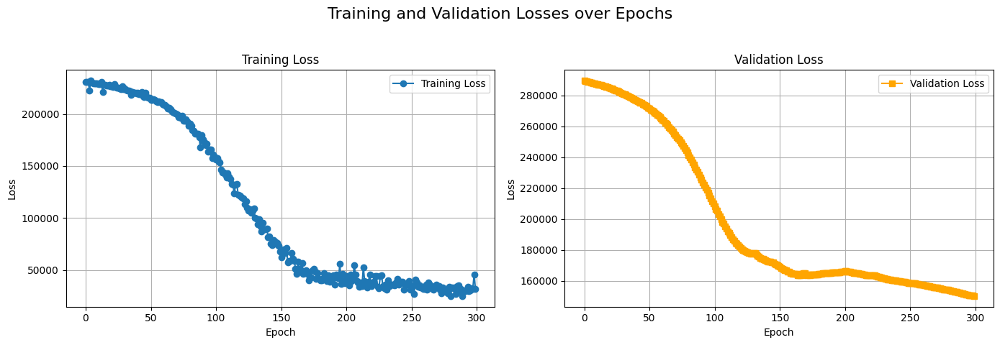

In [ ]:
import matplotlib.pyplot as plt

# Create a figure with two subplots side-by-side
fig, ax = plt.subplots(1, 2, figsize=(14, 5)) # Adjust figsize as needed for better readability

# Plot the training loss on the first subplot
ax[0].plot(_train_loss, label='Training Loss', marker='o')
ax[0].set_title("Training Loss")
ax[0].set_xlabel("Epoch")
ax[0].set_ylabel("Loss")
ax[0].legend()
ax[0].grid(True)

# Plot the validation loss on the second subplot
ax[1].plot(_val_loss, label='Validation Loss', marker='s', color='orange')
ax[1].set_title("Validation Loss")
ax[1].set_xlabel("Epoch")
ax[1].set_ylabel("Loss")
ax[1].legend()
ax[1].grid(True)

# Add a main title for the entire figure
fig.suptitle("Training and Validation Losses over Epochs", fontsize=16)

plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to prevent labels from overlapping and make space for suptitle
plt.show()

In [ ]:
# ===== Corrected animation cell: prediction vs GT + roadgraph lane segments =====
import torch
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

def _move_batch_to_device(batch, device):
    """PyG Data.to(device) does not reliably move nested dict values; do it explicitly."""
    batch.x_dict = {k: v.to(device, non_blocking=True) for k, v in batch.x_dict.items()}
    new_pids = {}
    for k, v in batch.pids_dict.items():
        new_pids[k] = v.to(device, non_blocking=True) if torch.is_tensor(v) else v
    batch.pids_dict = new_pids
    batch.y = batch.y.to(device, non_blocking=True)
    return batch

def _to_np(x):
    if torch.is_tensor(x):
        return x.detach().float().cpu().numpy()
    return np.asarray(x, dtype=np.float32)

def _plot_roadgraph_segments(ax, roadgraph_feats, alpha=0.35, linewidth=1.0, max_segments=None):
    """
    Plot Waymo roadgraph as line segments.
    Expected format (as in the provided notebook):
      roadgraph_feats: [N_seg, F] where:
        cols 0:3 = Ds (x_start,y_start,z_start)
        cols 3:6 = De (x_end,y_end,z_end)
    """
    if roadgraph_feats is None:
        return

    rg = _to_np(roadgraph_feats)
    if rg.ndim != 2 or rg.shape[0] == 0 or rg.shape[1] < 6:
        return

    if max_segments is not None and rg.shape[0] > max_segments:
        # downsample uniformly to keep notebooks responsive
        idx = np.linspace(0, rg.shape[0]-1, max_segments).astype(np.int64)
        rg = rg[idx]

    xs0, ys0 = rg[:, 0], rg[:, 1]
    xs1, ys1 = rg[:, 3], rg[:, 4]

    # Draw each segment; keep it simple and robust
    for x0, y0, x1, y1 in zip(xs0, ys0, xs1, ys1):
        ax.plot([x0, x1], [y0, y1], alpha=alpha, linewidth=linewidth, label="_nolegend_")

def animate_prediction_vs_gt_with_roadgraph(pred_xy, gt_xy, roadgraph_feats=None,
                                            interval_ms=120, pad=5.0, title=None,
                                            rg_alpha=0.35, rg_linewidth=1.0, rg_max_segments=6000):
    """In-notebook JS animation (no ffmpeg). Roadgraph is drawn once as a static background."""
    pred_xy = _to_np(pred_xy)
    gt_xy   = _to_np(gt_xy)

    T = int(min(pred_xy.shape[0], gt_xy.shape[0]))
    pred_xy = pred_xy[:T]
    gt_xy   = gt_xy[:T]

    pts_for_scale = [pred_xy, gt_xy]
    if roadgraph_feats is not None:
        rg = _to_np(roadgraph_feats)
        if rg.ndim == 2 and rg.shape[1] >= 6 and rg.shape[0] > 0:
            # include both segment endpoints for scale estimation
            pts_for_scale.append(rg[:, 0:2])
            pts_for_scale.append(rg[:, 3:5])

    all_pts = np.concatenate(pts_for_scale, axis=0)
    max_abs = float(np.max(np.abs(all_pts)))
    lim = max_abs + float(pad) if np.isfinite(max_abs) else 50.0

    fig, ax = plt.subplots(figsize=(7, 7))
    ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(-lim, lim)
    ax.set_ylim(-lim, lim)
    ax.grid(True)
    if title is not None:
        ax.set_title(title)

    # Static roadgraph background
    _plot_roadgraph_segments(
        ax,
        roadgraph_feats,
        alpha=rg_alpha,
        linewidth=rg_linewidth,
        max_segments=rg_max_segments

    )

    (pred_line,) = ax.plot([], [], linewidth=2, label="pred")
    (gt_line,)   = ax.plot([], [], linewidth=2, label="gt")
    (pred_pt,)   = ax.plot([], [], marker="o")
    (gt_pt,)     = ax.plot([], [], marker="o")
    ax.legend(loc="upper right")

    def init():
        pred_line.set_data([], [])
        gt_line.set_data([], [])
        pred_pt.set_data([], [])
        gt_pt.set_data([], [])
        return pred_line, gt_line, pred_pt, gt_pt

    def update(f):
      px, py = pred_xy[:f+1, 0], pred_xy[:f+1, 1]
      gx, gy = gt_xy[:f+1, 0], gt_xy[:f+1, 1]

      pred_line.set_data(px, py)
      gt_line.set_data(gx, gy)

      pred_pt.set_data([px[-1]], [py[-1]])
      gt_pt.set_data([gx[-1]], [gy[-1]])

      return pred_line, gt_line, pred_pt, gt_pt


    anim = FuncAnimation(fig, update, frames=T, init_func=init, interval=interval_ms, blit=True)
    plt.close(fig)
    return HTML(anim.to_jshtml())

In [ ]:
def display_animation_from_loader(model, _loader, scen_i=0):
    # ---- Run one example from an existing loader ----
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    batch = next(iter(_loader))
    batch = _move_batch_to_device(batch, device)

    with torch.no_grad():
        pred, _ = model(batch.x_dict, batch.pids_dict)  # [B, T, 4]
        gt   = batch.y                               # [B, T, 2]

    pred_scenario = pred[scen_i]
    pred_mu = pred_scenario[:, 0:2]
    pred_pos = torch.cumsum(pred_mu, dim=0)

    gt_scenario = gt[scen_i]
    gt_pos = torch.cumsum(gt_scenario, dim=0)

    # Roadgraph segments (as stored in the provided notebook)
    all_roads = batch.x_dict.get("roadgraphs", None)
    rg_batch_idx = batch.pids_dict.get('roadgraphs_batch', None)

    if all_roads is not None and rg_batch_idx is not None:
        # Create a mask for the chosen scenario index (scen_i)
        mask = (rg_batch_idx == scen_i)
        # Only keep road segments for this specific scenario
        scenario_roads = all_roads[mask]
    else:
        scenario_roads = None

    html = animate_prediction_vs_gt_with_roadgraph(
        pred_xy=pred_pos,
        gt_xy=gt_pos,
        roadgraph_feats=scenario_roads,
        interval_ms=120,
        pad=5.0,
        title=f"Scenario {scen_i}: prediction vs GT (with roadgraph)"
    )
    display(html)

In [ ]:
display_animation_from_loader(model, train_pyg_loader)

In [ ]:
display_animation_from_loader(model, val_pyg_loader)